In [ ]:
### Load the libraries

In [2]:
#cells will fill entire width of the browser
import datetime

from IPython.display import display, HTML

display(HTML(data="""
<style>
    div#notebook-container    { width: 95%; }
    div#menubar-container     { width: 65%; }
    div#maintoolbar-container { width: 99%; }
</style>
"""))

#Tells Jupyter to reload custom classes from scratch everytime an import cell is run, if you edit a custom class
#between imports Jupyter would otherwise need to be restarted completely. Buyer beware: old class objects in the
#current namespace will cause errors at execution
%load_ext autoreload
%autoreload 2

#switches matplotlib to show plots in the browser rather than opening a new window
%matplotlib inline

#always forget to do this for better looking plots
import seaborn
seaborn.set()

In [42]:
import pandas as pd
import seaborn as sns
import numpy as np
import sys
import os
import warnings
import re
from sklearn.metrics import mean_absolute_error, r2_score
from sklearn.metrics import mean_squared_error
from matplotlib.pyplot import figure
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.feature_selection import SelectKBest, f_classif, mutual_info_classif
from sklearn.metrics import roc_auc_score as auc
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor
import time
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import plotly.graph_objects as go

from math import sqrt
from numpy import concatenate
from pandas import DataFrame
from pandas import concat
from sklearn.metrics import mean_squared_error
import pickle
import holidays
import datetime

In [20]:
df = pd.read_csv( "./sip_dam_data.csv")
df.head()

,Unnamed: 0,SIP,DAM
0,2016-01-01 00:00:00,29.60,31.10
1,2016-01-01 00:30:00,48.14,31.10
2,2016-01-01 01:00:00,49.02,37.58
3,2016-01-01 01:30:00,46.00,37.58
4,2016-01-01 02:00:00,48.50,36.53


In [21]:
df.shape

(89953, 3)

In [22]:
df.rename(columns = {'Unnamed: 0':'timestamp'}, inplace = True)

In [23]:
df[["timestamp"]] = df[["timestamp"]].apply(pd.to_datetime)

In [38]:
end_date = df["timestamp"]. max()
start_date = df["timestamp"]. min()

In [40]:
print(end_date)

2021-02-17 00:00:00


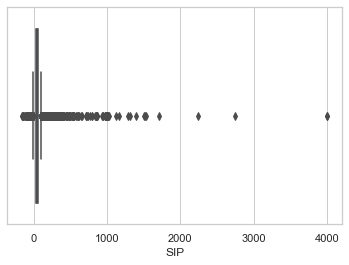

In [27]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x=df["SIP"])

In [79]:
df["SIP"].describe()

count    89918.000000
mean        44.300704
std         42.136848
min       -153.890000
25%         27.170000
50%         39.590000
75%         55.600000
max       4000.000000
Name: SIP, dtype: float64

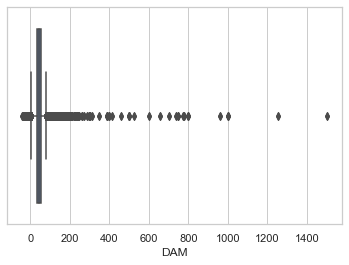

In [28]:
sns.set_theme(style="whitegrid")
ax = sns.boxplot(x=df["DAM"])

In [80]:
df["DAM"].describe()

count    89947.000000
mean        44.946502
std         24.044061
min        -38.800000
25%         33.825000
50%         42.530000
75%         52.900000
max       1500.000000
Name: DAM, dtype: float64

I have noticed that there are some outliers present for both

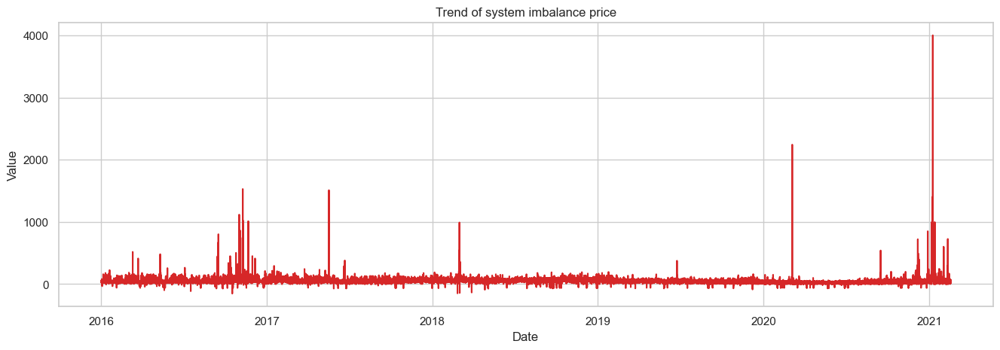

In [33]:
start_date = datetime.datetime(year=2016, month=1, day=1)
end_date = datetime.datetime(year=2021, month=2, day=17)

In [43]:
df_date = pd.DataFrame()
df_date['dates'] = pd.date_range(start_date, end_date)
df_date.head()

In [43]:
# creating weekday & weekend function to see trends
def is_weekend(d):
    """
    :param d: Accepts the date format.
    :return: 1 if it's weekend & 0 if it's weekday
    """
    if d.weekday() > 4:
        return 0
    else:
        return 1

# is day or night check?
def is_day_or_night(d):
    """
    :param d: Accepts the date format.
    :return: time of the day
    """

    hour = d.hour
    if (hour>=0) & (hour<6):
        tod = 'night'
    elif (hour>=6) & (hour<12):
        tod = 'morning'
    elif (hour>=12) & (hour<18):
        tod = 'afternoon'
    else:
        tod = 'evening'

    return tod

def is_holiday(d):
    """
    :param d: Accepts the date format.
    :return:
    """
    uk_holidays = holidays.UnitedKingdom()
    holiday = uk_holidays.get(d)
    if holiday is not None:
        return 1
    else:
        return 0


In [49]:
df['is_holiday'] = df['timestamp'].apply(is_holiday)

In [50]:
df.head()

,timestamp,SIP,DAM,is_holiday
0,2016-01-01 00:00:00,29.60,31.10,1
1,2016-01-01 00:30:00,48.14,31.10,1
2,2016-01-01 01:00:00,49.02,37.58,1
3,2016-01-01 01:30:00,46.00,37.58,1
4,2016-01-01 02:00:00,48.50,36.53,1


In [56]:
df['time_of_the_day'] = df['timestamp'].apply(is_day_or_night)

In [60]:
df.head()

,timestamp,SIP,DAM,is_holiday,time_of_the_day
0,2016-01-01 00:00:00,29.60,31.10,1,night
1,2016-01-01 00:30:00,48.14,31.10,1,night
2,2016-01-01 01:00:00,49.02,37.58,1,night
3,2016-01-01 01:30:00,46.00,37.58,1,night
4,2016-01-01 02:00:00,48.50,36.53,1,night


In [69]:
df['is_holiday'] = df['is_holiday'].astype('object')

In [70]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 89953 entries, 0 to 89952
Data columns (total 5 columns):
 #   Column           Non-Null Count  Dtype         
---  ------           --------------  -----         
 0   timestamp        89953 non-null  datetime64[ns]
 1   SIP              89918 non-null  float64       
 2   DAM              89947 non-null  float64       
 3   is_holiday       89953 non-null  object        
 4   time_of_the_day  89953 non-null  object        
dtypes: datetime64[ns](1), float64(2), object(2)
memory usage: 3.4+ MB


In [71]:
df_time_series =  df.set_index('timestamp', drop=True)

In [72]:
df_time_series.head()

,SIP,DAM,is_holiday,time_of_the_day
timestamp,,,,
2016-01-01 00:00:00,29.60,31.10,1,night
2016-01-01 00:30:00,48.14,31.10,1,night
2016-01-01 01:00:00,49.02,37.58,1,night
2016-01-01 01:30:00,46.00,37.58,1,night
2016-01-01 02:00:00,48.50,36.53,1,night


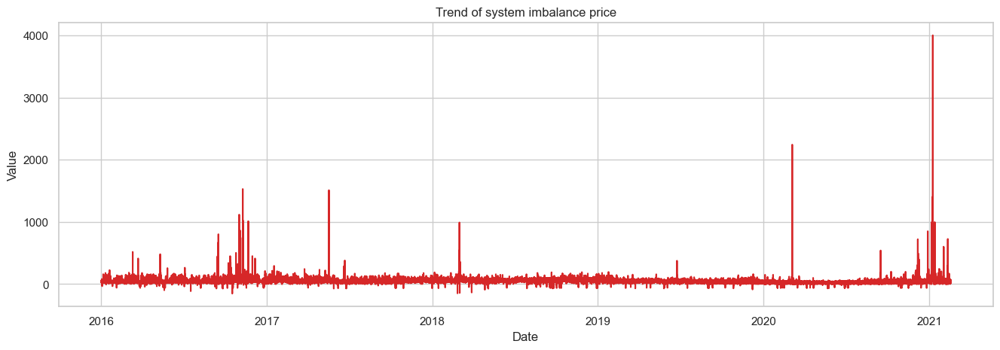

In [33]:
# Draw Plot
def plot_df(df, x, y, title="", xlabel='Date', ylabel='Value', dpi=100):
    plt.figure(figsize=(16,5), dpi=dpi)
    plt.plot(x, y, color='tab:red')
    plt.gca().set(title=title, xlabel=xlabel, ylabel=ylabel)
    plt.show()

plot_df(df, x=df_time_series.index, y=df_time_series['SIP'], title='Trend of system imbalance price')

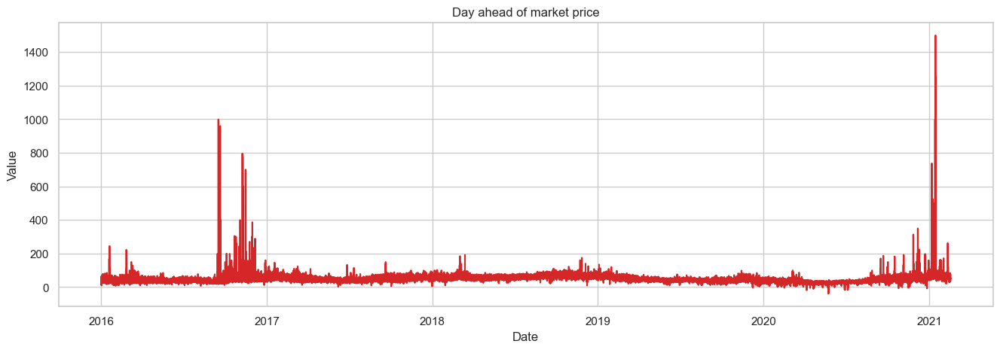

In [63]:
plot_df(df, x=df_time_series.index, y=df_time_series['DAM'], title='Day ahead of market price')

In [66]:
import plotly.graph_objects as go

fig = go.Figure()

fig.add_trace(
    go.Scatter(
        x=df_time_series.index,
        y=df_time_series['SIP'],
        name="System Imbalance Price",
    ))

fig.add_trace(
    go.Scatter(
        x=df_time_series.index,
        y=df_time_series['DAM'],
        name="Day ahead of market",
    ))
fig.show()

In [78]:
import plotly.express as px
fig = px.line(df_time_series, x=df_time_series.index, y=df_time_series.DAM, facet_col="is_holiday")
fig.show()

In [77]:
import plotly.express as px
fig = px.line(df_time_series, x=df_time_series.index, y=df_time_series.SIP, facet_col="is_holiday")
fig.show()

We can conclude from the above graphs that SIP & DAM remains almost constant when compared to non-holiday periods.